In [1]:
import requests # library to handle requests
import pandas as pd # library for data analsysis
import numpy as np # library to handle data in a vectorized manner
import random # library for random number generation

!conda install -c conda-forge geopy --yes 
from geopy.geocoders import Nominatim # module to convert an address into latitude and longitude values

# libraries for displaying images
from IPython.display import Image 
from IPython.core.display import HTML 
    
# tranforming json file into a pandas dataframe library pandas.json_normalize
from pandas.io.json import json_normalize

!conda install -c conda-forge folium=0.5.0 --yes
import folium # plotting library

print('Folium installed')
print('Libraries imported.')

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - geopy


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    geographiclib-1.50         |             py_0          34 KB  conda-forge
    geopy-2.0.0                |     pyh9f0ad1d_0          63 KB  conda-forge
    python_abi-3.6             |          1_cp36m           4 KB  conda-forge
    certifi-2020.6.20          |   py36h9f0ad1d_0         151 KB  conda-forge
    ca-certificates-2020.6.20  |       hecda079_0         145 KB  conda-forge
    openssl-1.1.1g             |       h516909a_1         2.1 MB  conda-forge
    ------------------------------------------------------------
                                           Total:         2.5 MB

The following NEW packages will be INSTALLED:

    geographiclib:   1.50-py_0          conda-forge
    geopy:           

In [41]:
!wget -q -O 'MCI_2014_to_2019.csv' https://opendata.arcgis.com/datasets/0c5fa2b642214e8baf0601405abccf30_0.csv?outSR=%7B%22latestWkid%22%3A3857%2C%22wkid%22%3A102100%7D
print('Data downloaded!')

Data downloaded!


In [138]:
crimes_df = pd.read_csv('MCI_2014_to_2019.csv')

crimes2_df = crimes_df[['MCI', 'occurrenceyear', 'Lat', 'Long', 'Neighbourhood']]
crimes2_df.dropna(subset=['occurrenceyear'])

crimes3_df = crimes2_df.loc[crimes2_df['occurrenceyear'] == 2019.0]
crimes3_df.reset_index(drop=True, inplace=True)
crimes3_df.head()

,MCI,occurrenceyear,Lat,Long,Neighbourhood
0,Assault,2019.0,43.810932,-79.227135,Malvern (132)
1,Assault,2019.0,43.663906,-79.384155,Church-Yonge Corridor (75)
2,Assault,2019.0,43.655777,-79.380676,Church-Yonge Corridor (75)
3,Assault,2019.0,43.723015,-79.415932,Bedford Park-Nortown (39)
4,Break and Enter,2019.0,43.648773,-79.528748,Islington-City Centre West (14)


In [209]:
paris_crimes = {'Assault': 26299, 'Break and Enter': 13743, 'Robbery':12757, 'Theft Over': 130898, 'Other':50514}
paris = pd.Series(paris_crimes)
paris_df = pd.DataFrame(paris)
paris_df.rename(columns = {0:'Count_Paris'}, inplace = True)
paris_df

,Count_Paris
Assault,26299
Break and Enter,13743
Robbery,12757
Theft Over,130898
Other,50514


# Results

## Stats

In [203]:
type_df = crimes3_df['MCI'].value_counts().to_frame()
type_df

,MCI
Assault,19600
Break and Enter,8278
Auto Theft,5137
Robbery,3408
Theft Over,1251


In [204]:
Worst_Neigh_df = crimes3_df['Neighbourhood'].value_counts().to_frame()
Worst_Neigh_df.sort_values(['Neighbourhood'], ascending= False, axis=0)
Worst_Neigh_df.head(10)

,Neighbourhood
Church-Yonge Corridor (75),1396
Waterfront Communities-The Island (77),1373
Bay Street Corridor (76),1350
Moss Park (73),1066
West Humber-Clairville (1),987
Downsview-Roding-CFB (26),773
Kensington-Chinatown (78),762
York University Heights (27),703
Woburn (137),638
West Hill (136),613


In [205]:
Best_Neigh_df = crimes3_df['Neighbourhood'].value_counts().to_frame()
Best_Neigh_df.sort_values(['Neighbourhood'], inplace = True)
Best_Neigh_df.head(10)

,Neighbourhood
Guildwood (140),45
Woodbine-Lumsden (60),53
Lambton Baby Point (114),57
Markland Wood (12),67
Old East York (58),71
Yonge-St.Clair (97),79
Etobicoke West Mall (13),81
Maple Leaf (29),81
Humber Heights-Westmount (8),81
Alderwood (20),85


In [206]:
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt

mpl.style.use('ggplot') # optional: for ggplot-like style

print('Matplotlib version: ', mpl.__version__)

Matplotlib version:  3.0.2


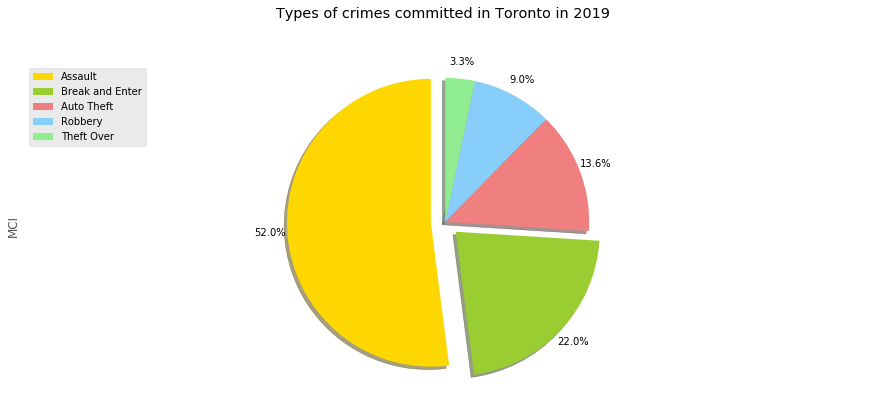

In [207]:
colors_list = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue', 'lightgreen', 'pink']
explode_list = [0.1, 0.1, 0, 0, 0]

type_df['MCI'].plot(kind='pie',
                            figsize=(15, 6),
                            autopct='%1.1f%%', 
                            startangle=90,    
                            shadow=True,       
                            labels=None,        
                            pctdistance=1.12,    
                            colors=colors_list, 
                            explode=explode_list
                            )


plt.title('Types of crimes committed in Toronto in 2019', y=1.12) 

plt.axis('equal') 

plt.legend(labels= type_df.index, loc='upper left') 

plt.show()

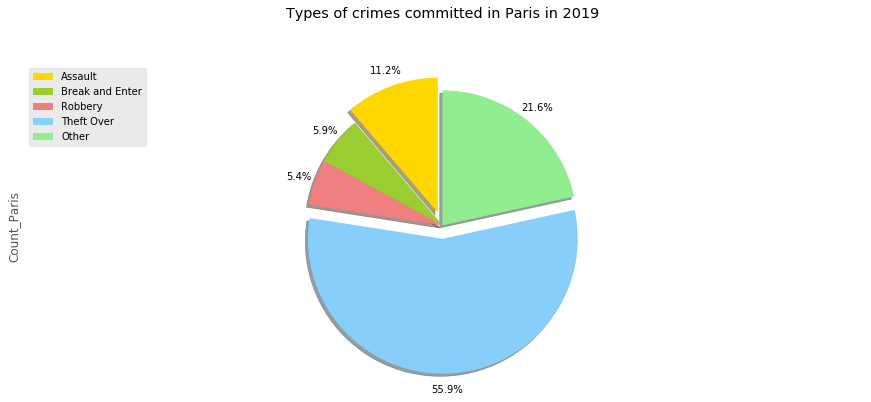

In [210]:
colors_list2 = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue', 'lightgreen', 'pink']
explode_list2 = [0.1, 0, 0, 0.1, 0] # ratio for each continent with which to offset each wedge.

paris_df['Count_Paris'].plot(kind='pie',
                            figsize=(15, 6),
                            autopct='%1.1f%%', 
                            startangle=90,    
                            shadow=True,       
                            labels=None,         
                            pctdistance=1.12,    
                            colors=colors_list2,
                            explode=explode_list2
                            )

# scale the title up by 12% to match pctdistance
plt.title('Types of crimes committed in Paris in 2019', y=1.12) 

plt.axis('equal') 

# add legend
plt.legend(labels= paris_df.index, loc='upper left') 

plt.show()

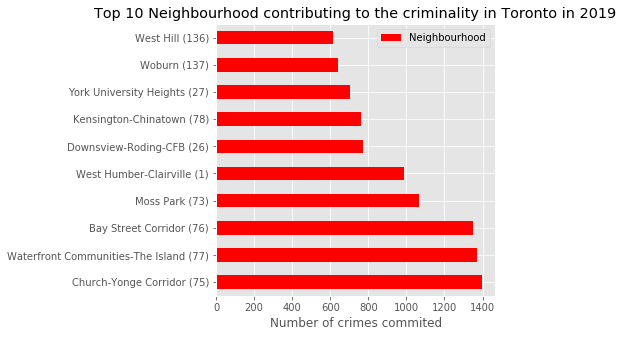

In [211]:
Worst_Neigh_df[:10].plot(kind='barh', figsize=(5, 5), color='red')
plt.xlabel('Number of crimes commited')
plt.title('Top 10 Neighbourhood contributing to the criminality in Toronto in 2019')

#for index, value in enumerate(Worst_Neigh_df): 
 #   label = format(int(value), ',')
  #  plt.annotate(label, xy=(value - 1400, index - 0.10), color='white')
plt.show()

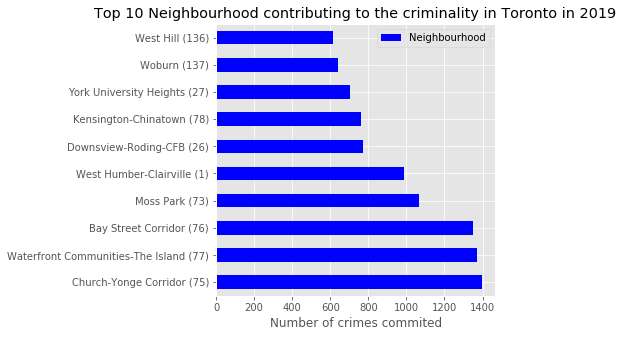

In [212]:
Worst_Neigh_df[:10].plot(kind='barh', figsize=(5, 5), color='blue')
plt.xlabel('Number of crimes commited')
plt.title('Top 10 Neighbourhood contributing to the criminality in Toronto in 2019')

plt.show()

In [213]:
latitude = 43.651070
longitude = -79.347015

from folium import plugins


map_crimes = folium.Map(location = [latitude, longitude], zoom_start = 12)

crimes = plugins.MarkerCluster().add_to(map_crimes)

for lat, lng, label, in zip(crimes3_df.Lat, crimes3_df.Long, crimes3_df.MCI):
    folium.Marker(
        location=[lat, lng],
        icon=None,
        popup=label,
    ).add_to(crimes)

map_crimes

In [45]:
CLIENT_ID = 'XSFJHKKTDE3HAFUSTBC0LNZ2ODEUADQZTVCADBTUDHVZAPSV' 
CLIENT_SECRET = 'O55ZJHLXQ43GSSMZCYUHBHWXEGHZBRQQPWAWJPWPEOG0PCMO' 
VERSION = '20180604'
LIMIT = 30
print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: XSFJHKKTDE3HAFUSTBC0LNZ2ODEUADQZTVCADBTUDHVZAPSV
CLIENT_SECRET:O55ZJHLXQ43GSSMZCYUHBHWXEGHZBRQQPWAWJPWPEOG0PCMO


In [46]:
address = 'Toronto, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Toronto are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Toronto are 43.6534817, -79.3839347.


In [47]:
import requests
 
url = "https://ckan0.cf.opendata.inter.prod-toronto.ca/api/3/action/package_show"
params = { "id": "4def3f65-2a65-4a4f-83c4-b2a4aed72d46"}
package = requests.get(url, params = params).json()

In [49]:
for idx, resource in enumerate(package["result"]["resources"]):
    if resource["datastore_active"]:
        url = "https://ckan0.cf.opendata.inter.prod-toronto.ca/api/3/action/datastore_search"
        p = { "id": resource["id"] }
        data = requests.get(url, params = p).json()
        geojson_df = pd.DataFrame(data["result"]["records"])
        break
geojson_df.head()

,AREA_ATTR_ID,AREA_DESC,AREA_ID,AREA_LONG_CODE,AREA_NAME,AREA_SHORT_CODE,LATITUDE,LONGITUDE,OBJECTID,PARENT_AREA_ID,Shape__Area,Shape__Length,X,Y,_id,geometry
0,25926662,Wychwood (94),25886861,094,Wychwood (94),094,43.676919,-79.425515,16491505,49885,3.217960e+06,7515.779658,None,None,7421,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4359..."
1,25926663,Yonge-Eglinton (100),25886820,100,Yonge-Eglinton (100),100,43.704689,-79.403590,16491521,49885,3.160334e+06,7872.021074,None,None,7422,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4109..."
2,25926664,Yonge-St.Clair (97),25886834,097,Yonge-St.Clair (97),097,43.687859,-79.397871,16491537,49885,2.222464e+06,8130.411276,None,None,7423,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3911..."
3,25926665,York University Heights (27),25886593,027,York University Heights (27),027,43.765736,-79.488883,16491553,49885,2.541821e+07,25632.335242,None,None,7424,"{""type"": ""Polygon"", ""coordinates"": [[[-79.5052..."
4,25926666,Yorkdale-Glen Park (31),25886688,031,Yorkdale-Glen Park (31),031,43.714672,-79.457108,16491569,49885,1.156669e+07,13953.408098,None,None,7425,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4396..."


In [50]:
foursquare_df = geojson_df[['AREA_DESC', 'LATITUDE', 'LONGITUDE']]
foursquare_df.rename(columns = {'AREA_DESC':'Neighbourhood', 'LATITUDE': 'Lat', 'LONGITUDE': 'Long'}, inplace = True)
foursquare_df.head()

,Neighbourhood,Lat,Long
0,Wychwood (94),43.676919,-79.425515
1,Yonge-Eglinton (100),43.704689,-79.403590
2,Yonge-St.Clair (97),43.687859,-79.397871
3,York University Heights (27),43.765736,-79.488883
4,Yorkdale-Glen Park (31),43.714672,-79.457108


In [191]:
Best_Neigh_df = crimes3_df['Neighbourhood'].value_counts().to_frame()
Best_Neigh_df.sort_values(['Neighbourhood'], inplace = True)

Best_df = Best_Neigh_df.loc[Best_Neigh_df['Neighbourhood'] <= 85]
Best_df.reset_index(level = 0, inplace = True)
Best_df.rename(columns = {'index':'Neighbourhood', 'Neighbourhood': 'Count'}, inplace = True)
Best_df

,Neighbourhood,Count
0,Guildwood (140),45
1,Woodbine-Lumsden (60),53
2,Lambton Baby Point (114),57
3,Markland Wood (12),67
4,Old East York (58),71
5,Yonge-St.Clair (97),79
6,Etobicoke West Mall (13),81
7,Maple Leaf (29),81
8,Humber Heights-Westmount (8),81
9,Alderwood (20),85


In [199]:
lat_coordinates = {'Guildwood (140)': 43.7552251, 
               'Woodbine-Lumsden (60)': 43.69992, 
               'Lambton Baby Point (114)':43.6558741,
               'Markland Wood (12)':43.63123865,
               'Old East York (58)':43.699971000000005,
               'Yonge-St.Clair (97)':43.6880189, 
               'Etobicoke West Mall (13)':43.6435491,
               'Maple Leaf (29)':43.7122767,
               'Humber Heights-Westmount (8)':42.9510358,
               'Alderwood (20)': 43.6017173, 
               'Lawrence Park North (105)':44.24463705}

long_coordinates = {'Guildwood (140)': -79.1982293, 
               'Woodbine-Lumsden (60)': -79.319279,
               'Lambton Baby Point (114)':-79.4964941,
               'Markland Wood (12)':-79.58543401986114,
               'Old East York (58)':-79.33251996261595,
               'Yonge-St.Clair (97)': -79.3945708,
               'Etobicoke West Mall (13)': -79.56532534553605,
               'Maple Leaf (29)': -79.4901977, 
               'Humber Heights-Westmount (8)': -81.2898857, 
               'Alderwood (20)': -79.5452325, 
               'Lawrence Park North (105)': -76.61765730030677}

total = {'Guildwood (140)': 45, 
               'Woodbine-Lumsden (60)':53,
               'Lambton Baby Point (114)':57,
               'Markland Wood (12)':67,
               'Old East York (58)':71,
               'Yonge-St.Clair (97)': 79,
               'Etobicoke West Mall (13)': 81,
               'Maple Leaf (29)': 81, 
               'Humber Heights-Westmount (8)':81, 
               'Alderwood (20)': 85, 
               'Lawrence Park North (105)': 85}

lat_c = pd.Series(lat_coordinates)
lat_c_df = pd.DataFrame(lat_c)
lat_c_df.rename(columns = {0:'Lat'}, inplace = True)
lat_c_df.reset_index(level = 0, inplace = True)
lat_c_df.rename(columns = {'index':'Neighbourhood'}, inplace = True)

long_c = pd.Series(long_coordinates)
long_c_df = pd.DataFrame(long_c)
long_c_df.rename(columns = {0:'Long'}, inplace = True)
long_c_df.reset_index(level = 0, inplace = True)
long_c_df.rename(columns = {'index':'Neighbourhood'}, inplace = True)

tot = pd.Series(total)
tot_df = pd.DataFrame(tot)
tot_df.rename(columns = {0:'Count'}, inplace = True)
tot_df.reset_index(level = 0, inplace = True)
tot_df.rename(columns = {'index':'Neighbourhood'}, inplace = True)

In [202]:
Neighb_df = lat_c_df.merge(long_c_df, how = 'inner', on = ['Neighbourhood', 'Neighbourhood'])
Final_df = Neighb_df.merge(tot_df, how = 'inner', on = ['Neighbourhood', 'Neighbourhood'])
Final_df

,Neighbourhood,Lat,Long,Count
0,Guildwood (140),43.755225,-79.198229,45
1,Woodbine-Lumsden (60),43.699920,-79.319279,53
2,Lambton Baby Point (114),43.655874,-79.496494,57
3,Markland Wood (12),43.631239,-79.585434,67
4,Old East York (58),43.699971,-79.332520,71
5,Yonge-St.Clair (97),43.688019,-79.394571,79
6,Etobicoke West Mall (13),43.643549,-79.565325,81
7,Maple Leaf (29),43.712277,-79.490198,81
8,Humber Heights-Westmount (8),42.951036,-81.289886,81
9,Alderwood (20),43.601717,-79.545232,85


In [ ]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

### Guidwood Neighbourhood

In [72]:
Guildwood = 'Guildwood, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Guildwood)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Guilwood are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Guilwood are 43.7552251, -79.1982293.


In [94]:
search_query = 'school'
radius = 1000
print(search_query + ' .... OK!')

school .... OK!


In [95]:
url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, search_query, radius, LIMIT)

results = requests.get(url).json()

In [96]:
guildwood_venues = results['response']['venues']

guildwood_df = json_normalize(guildwood_venues)
guildwood_df.shape

(6, 16)

In [97]:
filtered_columns = ['name', 'categories'] + [col for col in guildwood_df.columns if col.startswith('location.')] + ['id']
filtered_df = guildwood_df.loc[:, filtered_columns]


def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']


filtered_df['categories'] = filtered_df.apply(get_category_type, axis=1)


filtered_df.columns = [column.split('.')[-1] for column in filtered_df.columns]

filtered_df

,name,categories,address,cc,city,country,crossStreet,distance,formattedAddress,labeledLatLngs,lat,lng,state,id
0,Guildwood Junior Public School,Elementary School,225 Livingston Rd,CA,Scarborough,Canada,NaN,479,"[225 Livingston Rd, Scarborough ON, Canada]","[{'label': 'display', 'lat': 43.751232, 'lng':...",43.751232,-79.200455,ON,50ad356fe4b01386115397bd
1,Saint Ursula Catholic School,None,215 Livingston Road,CA,Toronto,Canada,Kingston and Eglinton,588,"[215 Livingston Road (Kingston and Eglinton), ...","[{'label': 'display', 'lat': 43.749941, 'lng':...",43.749941,-79.197893,ON,4d3b4cc9cc48224b19ad454f
2,Maplewood High School,High School,120 Galloway road,CA,Toronto,Canada,NaN,531,"[120 Galloway road, Toronto ON, Canada]","[{'label': 'display', 'lat': 43.75914021778785...",43.759140,-79.194444,ON,4d751f4fd238a1cd74c8df0e
3,Eastview Junior Public School,Elementary School,NaN,CA,NaN,Canada,NaN,762,[Canada],"[{'label': 'display', 'lat': 43.75914128278879...",43.759141,-79.190444,NaN,50a1426ce4b091ce32dcdf8b
4,Guildwood Public School swings,Playground,NaN,CA,NaN,Canada,NaN,951,[Canada],"[{'label': 'display', 'lat': 43.749597, 'lng':...",43.749597,-79.189316,NaN,4bd3422a41b9ef3b7db2ffe5
5,Laurier High School,High School,Guildwood Parkway,CA,Guildwood,Canada,NaN,907,"[Guildwood Parkway, Guildwood ON, Canada]","[{'label': 'display', 'lat': 43.74711836078261...",43.747118,-79.196984,ON,4c2cf6d0b34ad13a5b29ecce


In [98]:
filtered_df.name

0    Guildwood Junior Public School
1      Saint Ursula Catholic School
2             Maplewood High School
3     Eastview Junior Public School
4    Guildwood Public School swings
5               Laurier High School
Name: name, dtype: object

In [124]:
guildwood_rest = 'restaurant'
radius = 2000

url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, guildwood_rest, radius, LIMIT)
results = requests.get(url).json()

guildwood_rest = results['response']['venues']

gr_df = json_normalize(guildwood_rest)
gr_df.name

0             Caribbean Palms Restaurant
1              Red Chili Thai Restaurant
2            Abugida Restaurant & Lounge
3          Sunshine Caribbean Restaurant
4                      Makkah Restaurant
5              Little Coxwell Restaurant
6                        Restaurant Asal
7                    The Ritz Restaurant
8                       Faley Restaurant
9         Guest House Chinese Restaurant
10                    Mainsha Restaurant
11      Sunshine Bar & Restaurant Supply
12                      Faley Restaurant
13             Afghan Village Restaurant
14                      Hamdi restaurant
15     Rendez-Vous Restaurant Bar & Cafe
16                  East York Restaurant
17        Anatolian's Turkish Restaurant
18           Kabul Restaurant and Bakery
19                    Sandy's Restaurant
20               Greek Garden Restaurant
21                               Kouzina
22        Fasiledes Ethiopian Restaurant
23     South Sea Chinese Food Restaurant
24              

In [62]:
Woodbine_Heights = 'Woodbine Heights, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Woodbine_Heights)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Woodbine Heights are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Woodbine Heights are 43.69992, -79.319279.


In [63]:
Markland_Wood = 'Markland Wood, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Markland_Wood)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Markland_Wood are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Markland_Wood are 43.63123865, -79.58543401986114.


In [65]:
Yonge = 'Yonge-St. Clair, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Yonge)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Yonge-St. Clair are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Yonge-St. Clair are 43.6880189, -79.3945708.


In [66]:
Humber = 'Humber Heights-Westmount, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Humber)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Humber Heights-Westmount are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Humber Heights-Westmount are 43.6968603, -79.52592390089058.


In [149]:
Etobicoke = 'Etobicoke West Mall, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Etobicoke)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Etobicoke West Mall are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Etobicoke West Mall are 43.6435491, -79.56532534553605.


In [150]:
Baby_Point = 'Baby Point, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Baby_Point)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Baby_Point are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Baby_Point are 43.6558741, -79.4964941.


In [153]:
HEW = 'Westmount, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(HEW)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of HEW are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of HEW are 42.9510358, -81.2898857.


In [152]:
ML = 'Maple Leaf, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(ML)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of ML are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of ML are 43.7122767, -79.4901977.


In [154]:
Ald = 'Alderwood, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Ald)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Ald are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Ald are 43.6017173, -79.5452325.


In [155]:
LPN = 'Lawrence Park North, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(LPN)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of LPN are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of LPN are 44.24463705, -76.61765730030677.


In [156]:
OEY = 'Old East York, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(OEY)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of OEY are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of OEY are 43.699971000000005, -79.33251996261595.


In [ ]:
url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, search_query, radius, LIMIT)
url

In [ ]:
French Restaurant
School

In [16]:
geojson_df.loc[0, 'AREA_DESC']

'Wychwood (94)'

In [17]:
neighborhood_latitude = geojson_df.loc[0, 'LATITUDE'] 
neighborhood_longitude = geojson_df.loc[0, 'LONGITUDE'] 

neighborhood_name = geojson_df.loc[0, 'AREA_DESC']

print('Latitude and longitude values of {} are {}, {}.'.format(neighborhood_name, 
                                                               neighborhood_latitude, 
                                                               neighborhood_longitude))

Latitude and longitude values of Wychwood (94) are 43.6769192679, -79.425514947.


In [20]:
LIMIT = 100
radius = 10000
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighborhood_latitude, 
    neighborhood_longitude, 
    radius, 
    LIMIT)
url

'https://api.foursquare.com/v2/venues/explore?&client_id=XSFJHKKTDE3HAFUSTBC0LNZ2ODEUADQZTVCADBTUDHVZAPSV&client_secret=O55ZJHLXQ43GSSMZCYUHBHWXEGHZBRQQPWAWJPWPEOG0PCMO&v=20180604&ll=43.6769192679,-79.425514947&radius=10000&limit=100'

In [21]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5f5e36799ac4f15c3a735cca'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'}]},
  'headerLocation': 'Toronto',
  'headerFullLocation': 'Toronto',
  'headerLocationGranularity': 'city',
  'totalResults': 239,
  'suggestedBounds': {'ne': {'lat': 43.766919357900086,
    'lng': -79.30130807379298},
   'sw': {'lat': 43.58691917789991, 'lng': -79.54972182020701}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '52418b0b7e48222eea81d2d2',
       'name': 'Pukka Restaurant',
       'location': {'address': '778 St Clair Ave West',
        'crossStreet': 'St Clair West & Arlington Ave',
        'lat': 43.68105502412986,
        'lng': -79.4291869567722,
        'labeledLatLngs': [

In [11]:
toronto_geo = r'Neighbourhoods.geojson.json' # geojson file

# create a plain world map
toronto_map = folium.Map(location = [latitude, longitude], zoom_start = 12, tiles='Mapbox Bright')

toronto_map.choropleth(
    geo_data=toronto_geo,
    data=crimes4_df,
    columns=['Neighbourhood', 'Count'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Crimes in Toronto'
)
toronto_map

FileNotFoundError: [Errno 2] No such file or directory: 'Neighbourhoods.geojson.json'